# Solution of Question 1 - 1

In [29]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

In [30]:
#loading data into dataframe
df = pd.read_excel('AirQuality.xlsx')
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2004-03-10,18:00:00,2.6,1360.00,150,11.881723,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.60,48.875001,0.757754
1,2004-03-10,19:00:00,2.0,1292.25,112,9.397165,954.75,103.0,1173.75,92.0,1558.75,972.25,13.30,47.700000,0.725487
2,2004-03-10,20:00:00,2.2,1402.00,88,8.997817,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.90,53.975000,0.750239
3,2004-03-10,21:00:00,2.2,1375.50,80,9.228796,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.00,60.000000,0.786713
4,2004-03-10,22:00:00,1.6,1272.25,51,6.518224,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.15,59.575001,0.788794


In [31]:
#showing number of rows and coulmns in data set
df.shape

(9357, 15)

In [32]:
#checking correlation between different variables from dataset
df.corr()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
CO(GT),1.000000,0.041415,0.128351,-0.031377,0.029939,0.526450,-0.089981,0.671140,-0.073721,0.080316,-0.068952,-0.048231,-0.045892
PT08.S1(CO),0.041415,1.000000,0.170009,0.852659,0.933101,0.278029,0.086931,0.154058,0.845133,0.892436,0.754806,0.745344,0.764866
NMHC(GT),0.128351,0.170009,1.000000,0.037329,0.110097,-0.004413,0.048832,0.103345,0.162689,0.101189,-0.000008,0.008288,0.012500
C6H6(GT),-0.031377,0.852659,0.037329,1.000000,0.767401,-0.001163,0.512154,-0.010971,0.774649,0.641306,0.971370,0.925068,0.984556
PT08.S2(NMHC),0.029939,0.933101,0.110097,0.767401,1.000000,0.331331,-0.073748,0.176569,0.874761,0.909909,0.668984,0.585775,0.646535
NOx(GT),0.526450,0.278029,-0.004413,-0.001163,0.331331,1.000000,-0.436083,0.817138,0.035580,0.461916,-0.138457,-0.053008,-0.095841
PT08.S3(NOx),-0.089981,0.086931,0.048832,0.512154,-0.073748,-0.436083,1.000000,-0.256217,0.122672,-0.208935,0.588061,0.573513,0.621576
NO2(GT),0.671140,0.154058,0.103345,-0.010971,0.176569,0.817138,-0.256217,1.000000,-0.022092,0.253469,-0.084084,-0.081300,-0.060423
PT08.S4(NO2),-0.073721,0.845133,0.162689,0.774649,0.874761,0.035580,0.122672,-0.022092,1.000000,0.723670,0.755053,0.640685,0.691889
PT08.S5(O3),0.080316,0.892436,0.101189,0.641306,0.909909,0.461916,-0.208935,0.253469,0.723670,1.000000,0.503659,0.524922,0.519432


In [33]:
#eliminating the noise/outlier -200 values from dependent and independent variables
df = df[(df['NOx(GT)']>0)][(df['CO(GT)']>0)]

C:\Users\admin\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


In [34]:
x = df.iloc[:,[7]].values
print(x)
y = df.iloc[:,[2]].values
print(y)

[[166. ]
 [103. ]
 [131. ]
 ...
 [293. ]
 [234.5]
 [265.2]]
[[2.6]
 [2. ]
 [2.2]
 ...
 [2.4]
 [2.1]
 [2.2]]


In [35]:
print(x.shape)
print(y.shape)

(7261, 1)
(7261, 1)


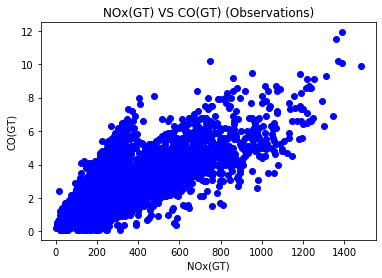

In [36]:
plt.scatter(x, y, color='blue')
plt.title('NOx(GT) VS CO(GT) (Observations)')
plt.xlabel('NOx(GT)')
plt.ylabel('CO(GT)')
plt.show()

In [37]:
# dividing the test and train data where test data size would be 1/3 of total data
from sklearn.model_selection import train_test_split 
X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size=1/3, random_state=0)

In [38]:
print(X_train.shape)
print(X_test.shape)
print(Y_train.shape)
print(Y_test.shape)

(4840, 1)
(2421, 1)
(4840, 1)
(2421, 1)


In [90]:
# Create the linear regression model
model = LinearRegression()

#fitting the training data to train the model
model.fit(X_train, Y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [91]:
# print the parameter theta1
print('Coefficient = ', model.coef_)
# print the parameter theta0
print('Intercept = ', model.intercept_)

Coefficient =  [[0.0053734]]
Intercept =  [0.83063043]


In [92]:
#predicting y value based on model prepared
y_pred = model.predict(X_test)
print(y_pred)

[[1.96710484]
 [1.78172249]
 [2.67908053]
 ...
 [1.90531072]
 [2.5689258 ]
 [2.07188616]]


Text(0, 0.5, 'CO(GT)')

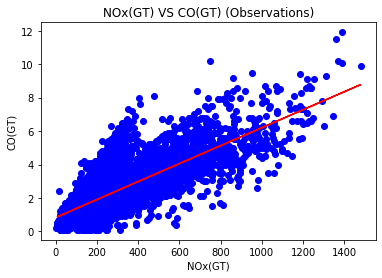

In [93]:
#ploting linear regression based on test data
plt.scatter(x,y,color='blue')
plt.plot(X_test, y_pred, color='red')
plt.title('NOx(GT) VS CO(GT) (Observations)')
plt.xlabel('NOx(GT)')
plt.ylabel('CO(GT)')

In [94]:
mse = mean_squared_error(Y_test,y_pred)
print("mean square error = ",mse)
print("Variance = ",r2_score(Y_test,y_pred))

mean square error =  0.7473130502792564
Variance =  0.6501970839454938


# Solution for Question 1 - 2

Now Building the linear regression model without Sklearn library

In [39]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [40]:
df = pd.read_excel('AirQuality.xlsx')
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2004-03-10,18:00:00,2.6,1360.00,150,11.881723,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.60,48.875001,0.757754
1,2004-03-10,19:00:00,2.0,1292.25,112,9.397165,954.75,103.0,1173.75,92.0,1558.75,972.25,13.30,47.700000,0.725487
2,2004-03-10,20:00:00,2.2,1402.00,88,8.997817,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.90,53.975000,0.750239
3,2004-03-10,21:00:00,2.2,1375.50,80,9.228796,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.00,60.000000,0.786713
4,2004-03-10,22:00:00,1.6,1272.25,51,6.518224,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.15,59.575001,0.788794


In [41]:
#eliminating the noise/outlier -200 values from dependent and independent variables
df = df[(df['NOx(GT)']>0)][(df['CO(GT)']>0)]
df.shape

C:\Users\admin\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


(7261, 15)

In [42]:
x = np.array(df.iloc[:,[7]].values)
y = np.array(df.iloc[:,[2]].values)

#splitting Data into training and test
x_train = np.array(df.iloc[0:5000,[7]].values)
x_test = np.array(df.iloc[5001:,[7]].values)

y_train = np.array(df.iloc[0:5000,[2]].values)
y_test = np.array(df.iloc[5001:,[2]].values)


In [43]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(5000, 1)
(5000, 1)
(2260, 1)
(2260, 1)


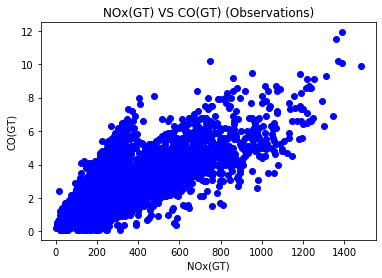

In [44]:
#plotting x and y points after removing outliers
plt.scatter(x, y, color='blue')
plt.title('NOx(GT) VS CO(GT) (Observations)')
plt.xlabel('NOx(GT)')
plt.ylabel('CO(GT)')
plt.show()

In [48]:
# Linear Regression

x_mean = x_train.mean()
y_mean = y_train.mean()

x_temp = x_train - x_mean

w1 = np.sum(x_temp*(y_train - y_mean))/np.sum(x_temp**2)
w0 = y_mean - w1 * x_mean
print("Intercept = ",w0," and Coefficient = ", w1)

Intercept =  0.9891490059737744  and Coefficient =  0.0056223097070594455


In [46]:
# Predicting the CO (y) based on Linear Regression model build above
y_pred = w0 + w1 * x_test

Text(0, 0.5, 'CO(GT)')

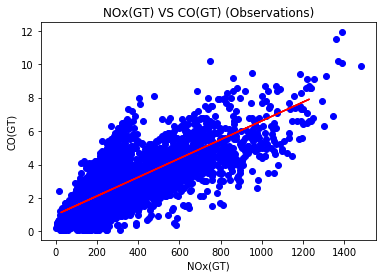

In [47]:
#ploting prediction based on test data
plt.scatter(x,y,color='blue')
plt.plot(x_test, y_pred, color='red')
plt.title('NOx(GT) VS CO(GT) (Observations)')
plt.xlabel('NOx(GT)')
plt.ylabel('CO(GT)')

# Solution of Question 2 

In [341]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split 


In [342]:
#loading data into dataframe
df = pd.read_excel('AirQuality.xlsx')
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2004-03-10,18:00:00,2.6,1360.00,150,11.881723,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.60,48.875001,0.757754
1,2004-03-10,19:00:00,2.0,1292.25,112,9.397165,954.75,103.0,1173.75,92.0,1558.75,972.25,13.30,47.700000,0.725487
2,2004-03-10,20:00:00,2.2,1402.00,88,8.997817,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.90,53.975000,0.750239
3,2004-03-10,21:00:00,2.2,1375.50,80,9.228796,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.00,60.000000,0.786713
4,2004-03-10,22:00:00,1.6,1272.25,51,6.518224,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.15,59.575001,0.788794


In [343]:
df.shape

(9357, 15)

In [344]:
#df = df.drop(columns=['PT08.S4(NO2)', 'C6H6(GT)', 'PT08.S5(O3)'])
#df.shape

In [345]:
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2004-03-10,18:00:00,2.6,1360.00,150,11.881723,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.60,48.875001,0.757754
1,2004-03-10,19:00:00,2.0,1292.25,112,9.397165,954.75,103.0,1173.75,92.0,1558.75,972.25,13.30,47.700000,0.725487
2,2004-03-10,20:00:00,2.2,1402.00,88,8.997817,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.90,53.975000,0.750239
3,2004-03-10,21:00:00,2.2,1375.50,80,9.228796,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.00,60.000000,0.786713
4,2004-03-10,22:00:00,1.6,1272.25,51,6.518224,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.15,59.575001,0.788794


In [346]:
df.dtypes

Date             datetime64[ns]
Time                     object
CO(GT)                  float64
PT08.S1(CO)             float64
NMHC(GT)                  int64
C6H6(GT)                float64
PT08.S2(NMHC)           float64
NOx(GT)                 float64
PT08.S3(NOx)            float64
NO2(GT)                 float64
PT08.S4(NO2)            float64
PT08.S5(O3)             float64
T                       float64
RH                      float64
AH                      float64
dtype: object

# Data Preprocessing

In [347]:
#converting Date and Time to Hour, Month and Day for computing
df['DATE'] = pd.to_datetime(df.Date, format='%m/%d/%Y')
df.set_index('DATE',inplace=True)
df['Time'] = df['Time'].astype(str)
df['HOUR'] = df['Time'].apply(lambda x: int(x.split(':')[0]))
df.astype({'HOUR':'int32'}).dtypes
df['MONTH'] = df.index.month
df['DAY'] = df.index.day
df.head()
df = df.drop('Date', axis=1)
df = df.drop('Time', axis=1)
df.head()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,HOUR,MONTH,DAY
DATE,,,,,,,,,,,,,,,,
2004-03-10,2.6,1360.00,150,11.881723,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.60,48.875001,0.757754,18,3,10
2004-03-10,2.0,1292.25,112,9.397165,954.75,103.0,1173.75,92.0,1558.75,972.25,13.30,47.700000,0.725487,19,3,10
2004-03-10,2.2,1402.00,88,8.997817,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.90,53.975000,0.750239,20,3,10
2004-03-10,2.2,1375.50,80,9.228796,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.00,60.000000,0.786713,21,3,10
2004-03-10,1.6,1272.25,51,6.518224,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.15,59.575001,0.788794,22,3,10


In [348]:
#replacing -200 with NaN and dropping NaN values
df.replace(-200.0, np.NaN, inplace=True)
df.dropna(how='all', inplace=True, axis=1)
df.dropna(how='all', inplace=True, axis=0)

df.isna().sum()

CO(GT)           1683
PT08.S1(CO)       366
NMHC(GT)         8443
C6H6(GT)          366
PT08.S2(NMHC)     366
NOx(GT)          1639
PT08.S3(NOx)      366
NO2(GT)          1642
PT08.S4(NO2)      366
PT08.S5(O3)       366
T                 366
RH                366
AH                366
HOUR                0
MONTH               0
DAY                 0
dtype: int64

In [349]:
df.corr()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,HOUR,MONTH,DAY
CO(GT),1.000000,0.879292,0.889734,0.931091,0.915519,0.795054,-0.703433,0.683533,0.630700,0.854183,0.022113,0.048896,0.048555,0.358159,0.111211,0.004168
PT08.S1(CO),0.879292,1.000000,0.790677,0.883821,0.892972,0.713687,-0.771918,0.641696,0.682874,0.899326,0.048628,0.114607,0.135323,0.328029,-0.040334,-0.020186
NMHC(GT),0.889734,0.790677,1.000000,0.902599,0.877691,0.812685,-0.771111,0.731193,0.853278,0.766731,0.391730,-0.191486,0.269734,0.327368,0.206724,-0.035617
C6H6(GT),0.931091,0.883821,0.902599,1.000000,0.981962,0.718914,-0.735711,0.614753,0.765717,0.865727,0.198891,-0.061643,0.167909,0.344149,0.128530,-0.013114
PT08.S2(NMHC),0.915519,0.892972,0.877691,0.981962,1.000000,0.704483,-0.796687,0.646520,0.777235,0.880590,0.241330,-0.090352,0.186906,0.389194,0.128228,-0.020852
NOx(GT),0.795054,0.713687,0.812685,0.718914,0.704483,1.000000,-0.655690,0.763170,0.233777,0.787056,-0.269713,0.221022,-0.149279,0.223241,0.141749,-0.033850
PT08.S3(NOx),-0.703433,-0.771918,-0.771111,-0.735711,-0.796687,-0.655690,1.000000,-0.652138,-0.538460,-0.796554,-0.145133,-0.056730,-0.232021,-0.323662,-0.061556,0.025285
NO2(GT),0.683533,0.641696,0.731193,0.614753,0.646520,0.763170,-0.652138,1.000000,0.157678,0.708259,-0.186369,-0.091845,-0.334798,0.364987,-0.174411,-0.019546
PT08.S4(NO2),0.630700,0.682874,0.853278,0.765717,0.777235,0.233777,-0.538460,0.157678,1.000000,0.591137,0.561333,-0.032188,0.629644,0.221248,0.176305,-0.040207
PT08.S5(O3),0.854183,0.899326,0.766731,0.865727,0.880590,0.787056,-0.796554,0.708259,0.591137,1.000000,-0.027193,0.124952,0.070738,0.245066,0.049023,-0.032606


In [350]:
df = df.drop(columns=['NMHC(GT)']) # dropping NMHC because it has highest NaN values. 
df.shape


(9357, 15)

In [351]:
df.isna().sum()

CO(GT)           1683
PT08.S1(CO)       366
C6H6(GT)          366
PT08.S2(NMHC)     366
NOx(GT)          1639
PT08.S3(NOx)      366
NO2(GT)          1642
PT08.S4(NO2)      366
PT08.S5(O3)       366
T                 366
RH                366
AH                366
HOUR                0
MONTH               0
DAY                 0
dtype: int64

In [352]:
df.shape

(9357, 15)

In [353]:
# imputing NaN values by mean
data_values = df.iloc[:,:].values

from sklearn.impute import SimpleImputer

imputer = SimpleImputer(missing_values=np.NaN, strategy='mean')
imputer = imputer.fit(data_values[:,:])
data_values[:,:] = imputer.transform(data_values[:,:])

data = pd.DataFrame(data_values)
data.columns = df.columns
data.isna().sum()

CO(GT)           0
PT08.S1(CO)      0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
HOUR             0
MONTH            0
DAY              0
dtype: int64

In [354]:
data.head()

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,HOUR,MONTH,DAY
0,2.6,1360.00,11.881723,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.60,48.875001,0.757754,18.0,3.0,10.0
1,2.0,1292.25,9.397165,954.75,103.0,1173.75,92.0,1558.75,972.25,13.30,47.700000,0.725487,19.0,3.0,10.0
2,2.2,1402.00,8.997817,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.90,53.975000,0.750239,20.0,3.0,10.0
3,2.2,1375.50,9.228796,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.00,60.000000,0.786713,21.0,3.0,10.0
4,1.6,1272.25,6.518224,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.15,59.575001,0.788794,22.0,3.0,10.0


In [355]:
#Standardizing data using Z-score
#cols = np.array(data.iloc[:,:])
for col in cols:
    z_score = (data[col] - data[col].mean())/data[col].std(ddof=0)
    df[col] = z_score.values
df

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,HOUR,MONTH,DAY
DATE,,,,,,,,,,,,,,,
2004-03-10,0.339856,1.223265,0.246331,0.407086,-0.418187,0.877450,-0.001720,0.695030,0.626540,-0.544709,-0.021054,-0.676520,0.939133,-0.962879,-0.667207
2004-03-10,-0.116071,0.904868,-0.093922,0.060108,-0.743922,1.344223,-0.479984,0.302364,-0.129371,-0.579359,-0.090280,-0.758039,1.083583,-0.962879,-0.667207
2004-03-10,0.035905,1.420648,-0.148612,0.000844,-0.599151,1.210150,0.021055,0.289840,0.131134,-0.741061,0.279416,-0.695505,1.228033,-0.962879,-0.667207
2004-03-10,0.035905,1.296109,-0.116980,0.035255,-0.387165,1.019468,0.203251,0.376035,0.462045,-0.845012,0.634383,-0.603357,1.372483,-0.962879,-0.667207
2004-03-10,-0.420023,0.810876,-0.488185,-0.395839,-0.599151,1.468365,0.066604,0.099770,0.223302,-0.827686,0.609344,-0.598098,1.516933,-0.962879,-0.667207
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2005-04-04,0.719796,1.008259,0.472004,0.620243,1.162400,-1.179331,1.747362,-0.241327,1.806812,0.408174,-1.177275,-0.678868,-0.216467,-0.672011,-1.348392
2005-04-04,0.187881,0.295097,0.174219,0.336352,0.550226,-0.920123,1.505952,-0.567688,0.630381,0.694039,-1.502784,-0.792458,-0.072017,-0.672011,-1.348392
2005-04-04,0.187881,0.198756,0.313821,0.472084,0.238452,-0.922109,1.403467,-0.634729,0.177218,0.991454,-1.819456,-0.972378,0.072433,-0.672011,-1.348392


# Gradient Descent Algorithm

In [421]:
from sklearn.model_selection import train_test_split 

x = np.array(df.iloc[:,2:].values)
y = np.array(df[['CO(GT)']])

X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size=1/3, random_state=0)

theta = np.ones((13,1)) # intializing [w0,w1,w2,w3,......,wD] features
learning_rate = 0.01 #learning rate
iterations = 50 #iterations

In [422]:
#Gradient Descent Algorithm for multiple features
costList=[]
iterationList = []
def multivariate_gradient_descent(theta, x, y, learning_rate, iterations):
    n = len(x)
    for i in range(iterations):
        y_pred = np.dot(x, theta)
        loss = y_pred - y
        cost_function = np.sum(loss ** 2) / (2 * n)
        costList.append(cost_function)
        theta_derivative = np.sum(x*loss)/n
        theta = theta - learning_rate * theta_derivative
        iterationList.append(i)
        print('theta_new = ',theta, ' iterations : ',i, ' Cost = ',cost_function)
        
    return theta, costList, iterationList

In [423]:
theta, costList, iterationList = multivariate_gradient_descent(theta, X_train, Y_train, learning_rate, iterations)

theta_new =  [[0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]
 [0.7312667]]  iterations :  0  Cost =  11.76756698392055
theta_new =  [[0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]
 [0.54645419]]  iterations :  1  Cost =  5.67342375879483
theta_new =  [[0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]
 [0.41935546]]  iterations :  2  Cost =  2.791168870001919
theta_new =  [[0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]
 [0.33194748]]  iterations :  3  Cost =  1.4279923024214536
theta_new =  [[0.27183551]
 [0.27183551]
 [0.27183551

theta_new =  [[0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]
 [0.13945542]]  iterations :  49  Cost =  0.20471742024335526


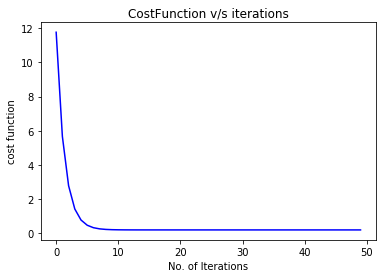

In [424]:
plt.title("CostFunction v/s iterations")
plt.xlabel("No. of Iterations")
plt.ylabel("cost function")
plt.plot(iterationList, costList, color="blue")

In [425]:
from sklearn.metrics import mean_squared_error as mse, r2_score as vs
import math

y_pred = np.dot(X_test, theta)
rmse = math.sqrt(mse(Y_test,y_pred))
print('Root Mean square error = ', rmse);
print('R^2 is = ', vs(Y_test, y_pred))

Root Mean square error =  0.6399592270802871
R^2 is =  0.5762092338934635


In [262]:
#Gradient Descent Algorithm for single feature (Build just for learning purpose)
def gradient_descent(x,y):
    w0_curr = w1_curr = 0
    learning_rate = 0.01
    iterations = 535
    n = len(x)
    
    for i in range(0, iterations):
        y_predicted = w0_curr + w1_curr * x
        error = y-y_predicted
        cost_func = (1/n)*sum(error**2)
        w1_derivative = sum(x * (y_predicted - y))
        w0_derivative = sum(y_predicted - y)
        w0_curr = w0_curr - learning_rate * w0_derivative
        w1_curr = w1_curr - learning_rate * w1_derivative
        print('w0_new = ',w0_curr,' w1_new = ',w1_curr, ' iterations : ',i, ' Cost = ',cost_func)
        

In [263]:
#gradient_descent(x,y)

# Stochastic Gradient Descent

In [367]:
x = np.array(df.iloc[:,2:].values)
y = np.array(df[['CO(GT)']])


# dividing the test and train data where test data size would be 1/3 of total data
from sklearn.model_selection import train_test_split 

X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size=1/3, random_state=0)

theta = np.ones((12,1)) # intializing [w0,w1,w2,w3,......,wD] features
learning_rate = 0.01 #learning rate
iterations = 10 #iterations

In [368]:
#Gradient Descent Algorithm for multiple features
def multivariate_stochastic_gradient_descent(theta, x, y, learning_rate, iterations):
    n = len(x)
    costList_full = []
    iterationList = []
    for i in range(0, iterations):
        iterationList.append(i)
        for j in range(0, n):
            XX = x[j,:]
            YY = y[j]
            y_pred = np.dot(XX.T, theta)
            loss = y_pred - YY
            print(loss)
            cost_function = loss ** 2
            theta_derivative = np.dot(XX.reshape(-1,1), loss.reshape(-1,1)) / n  
            theta = theta - learning_rate * theta_derivative
            #print('theta_new = ',theta, ' iterations : ',i, ' Cost = ',cost_function)
        
        y_pred_full = np.dot(x, theta)
        cost_func_full = (y_pred_full - y)**2 / (2*n)
        print('theta_new = ',theta, ' iterations : ',i, ' Cost = ',cost_func_full)
        costList_full.append(cost_func_full)
        
    return costList_full, iterationList

In [369]:
#costList_full, iterationList = multivariate_stochastic_gradient_descent(theta, X_train, Y_train, learning_rate, iterations)

In [370]:
#plt.title("CostFunction v/s iterations")
#plt.xlabel("No. of Iterations")
#plt.ylabel("cost function")
#plt.plot(iterationList, costList, color="blue")

In [371]:
# *** Stochastic Gradient Descent by sklearn lib ***

In [372]:
from sklearn.linear_model import SGDRegressor

In [373]:
sgd_regressor = SGDRegressor(max_iter=30, tol=learning_rate, eta0=1e-3)
sgd_regressor.fit(X_train,Y_train)

C:\Users\admin\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SGDRegressor(alpha=0.0001, average=False, early_stopping=False, epsilon=0.1,
             eta0=0.001, fit_intercept=True, l1_ratio=0.15,
             learning_rate='invscaling', loss='squared_loss', max_iter=30,
             n_iter_no_change=5, penalty='l2', power_t=0.25, random_state=None,
             shuffle=True, tol=0.01, validation_fraction=0.1, verbose=0,
             warm_start=False)

In [374]:
print("Coefficient = ", sgd_regressor.coef_)

Coefficient =  [ 0.21142087  0.13752992  0.34114927  0.08036772  0.14185799  0.20220678
  0.06540126 -0.04066701  0.02294708 -0.03783463  0.05747654  0.0348258
  0.0251697 ]


In [375]:
#print(y - sgd_regressor.predict((x)))

from sklearn.metrics import mean_squared_error as mse, r2_score as vs
import math

y_pred = sgd_regressor.predict(X_test)
sgd_rmse = math.sqrt(mse(Y_test,y_pred))
print('Root Mean square error = ', sgd_rmse);
print('R^2 is = ', vs(Y_test, y_pred))

Root Mean square error =  0.4582972673850288
R^2 is =  0.7826591231728686


# MiniBatch Gradient Descent Algorithm 

In [428]:
x = np.array(df.iloc[:,2:].values)
y = np.array(df[['CO(GT)']])

# dividing the test and train data where test data size would be 1/3 of total data
from sklearn.model_selection import train_test_split 

X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size=1/3, random_state=0)

data = np.hstack((X_train,Y_train))
np.random.shuffle(data)

theta = np.ones((13,1)) # intializing [w0,w1,w2,w3,......,wD] features
learning_rate = 0.1 #learning rate
iterations = 20 #iterations
batch_size = 100

In [429]:
def create_mini_batch(x,y, batch_size):
    mini_batches = []
    data = np.hstack((x,y))
    np.random.shuffle(data)
    for i in range(1, data.shape[0]):
        mini_batch = data[i*batch_size:(i+1)*batch_size, :]
        X_mini = mini_batch[:,:-1]
        Y_mini = mini_batch[:,-1].reshape((-1,1))
        mini_batches.append((X_mini, Y_mini))
    if data.shape[0] % batch_size != 0: 
        mini_batch = data[i * batch_size:data.shape[0]] 
        X_mini = mini_batch[:, :-1] 
        Y_mini = mini_batch[:, -1].reshape((-1, 1)) 
        mini_batches.append((X_mini, Y_mini)) 
    return mini_batches

In [430]:
#Mini Batch Gradient Descent Algorithm for multiple features
costList=[]
iterationList = []
def miniBatch_gradient_descent(theta, x, y, learning_rate, iterations, batch_size):
    n = len(x)
    for i in range(iterations):
        mini_batches = create_mini_batch(x,y, batch_size)
        for mini_batch in mini_batches:
            x_mini, y_mini = mini_batch
            y_pred = np.dot(x_mini, theta)
            loss = y_pred - y_mini
            cost_function = np.sum(loss ** 2) / (2 * n)
            costList.append(cost_function)
            theta_derivative = np.sum(x_mini*loss)/n
            theta = theta - learning_rate * theta_derivative
            iterationList.append(i)
            print('theta_new = ',theta, ' iterations : ',i, ' Cost = ',cost_function)
        
    return theta, costList, iterations

In [431]:
theta, costList, iterations = miniBatch_gradient_descent(theta, X_train, Y_train, learning_rate, iterations, batch_size)

theta_new =  [[0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]
 [0.96148292]]  iterations :  0  Cost =  0.17102030075748056
theta_new =  [[0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]
 [0.92112233]]  iterations :  0  Cost =  0.17519351131892782
theta_new =  [[0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]
 [0.89031043]]  iterations :  0  Cost =  0.1225603378914802
theta_new =  [[0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]
 [0.84912123]]  iterations :  0  Cost =  0.1568256271250049
theta_new =  [[0.81154124]
 [0.811

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]
 [0.17642261]]  iterations :  0  Cost =  0.0
theta_new =  [[0.17642261]
 [0.17642261]
 [0.176422

 [0.1461677]]  iterations :  1  Cost =  0.004014435845999523
theta_new =  [[0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]
 [0.14690854]]  iterations :  1  Cost =  0.003943320760061678
theta_new =  [[0.147106]
 [0.147106]
 [0.147106]
 [0.147106]
 [0.147106]
 [0.147106]
 [0.147106]
 [0.147106]
 [0.147106]
 [0.147106]
 [0.147106]
 [0.147106]
 [0.147106]]  iterations :  1  Cost =  0.004419093455006669
theta_new =  [[0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]
 [0.14708813]]  iterations :  1  Cost =  0.00358786682692424
theta_new =  [[0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]
 [0.14746186]]  iterations :  1  Cost =  0.0038900299550

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]
 [0.14041397]]  iterations :  1  Cost =  0.0
theta_new =  [[0.14041397]
 [0.14041397]
 [0.140413

 [0.14205275]]  iterations :  2  Cost =  0.004769955526331293
theta_new =  [[0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]
 [0.14330929]]  iterations :  2  Cost =  0.003768643561595117
theta_new =  [[0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]
 [0.14463065]]  iterations :  2  Cost =  0.003764422830012286
theta_new =  [[0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]
 [0.14414927]]  iterations :  2  Cost =  0.0028031894308914672
theta_new =  [[0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]
 [0.14620873]]  iterations 

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]

theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]

 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]
 [0.13727573]]  iterations :  2  Cost =  0.0
theta_new =  [[0.13727573]
 [0.13727573]
 [0.137275

theta_new =  [[0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]
 [0.14149287]]  iterations :  3  Cost =  0.002108091744118749
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0011709621517816712
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]

theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]

 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]
 [0.14184825]]  iterations :  3  Cost =  0.0
theta_new =  [[0.14184825]
 [0.14184825]
 [0.141848

theta_new =  [[0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]
 [0.14201001]]  iterations :  4  Cost =  0.002524328134940055
theta_new =  [[0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]
 [0.14127112]]  iterations :  4  Cost =  0.002672715945334525
theta_new =  [[0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]
 [0.14121041]]  iterations :  4  Cost =  0.0031398319261869653
theta_new =  [[0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]
 [0.14046654]]  iterations :  4  Cost =  0.003379502510497958
theta_new =  [[0.13991607]


theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1

 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1

 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1

 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1

 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1

 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1

 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]


 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]
 [0.1408869]]  iterations :  4  Cost =  0.0
theta_new =  [[0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]
 [0.14087769]]  iterations :  5  Cost =  0.002559806385472021
theta_new =  [[0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]
 [0.13992195]]  iterations :  5  Cost =  0.0028274419909421066
theta_new =  [[0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]
 [0.14078912]]  iterations :  5  Cost =  0.003995264651827906
theta_new =  

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]
 [0.13882792]]  iterations :  5  Cost =  0.0
theta_new =  [[0.13882792]
 [0.13882792]
 [0.138827

theta_new =  [[0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]
 [0.1394838]]  iterations :  6  Cost =  0.00384315091630282
theta_new =  [[0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]
 [0.13938295]]  iterations :  6  Cost =  0.003820026218135769
theta_new =  [[0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]
 [0.13959229]]  iterations :  6  Cost =  0.002685964618747025
theta_new =  [[0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]
 [0.13967975]]  iterations :  6  Cost =  0.0029001807076282768
theta_new =  [[0.13871039]
 [0.13871039]


 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]

theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]

theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]
 [0.13945048]]  iterations :  6  Cost =  0.0
theta_new =  [[0.13945048]
 [0.13945048]
 [0.139450

theta_new =  [[0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]
 [0.14184319]]  iterations :  7  Cost =  0.0028775449890897408
theta_new =  [[0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]
 [0.14095212]]  iterations :  7  Cost =  0.0025035050844323587
theta_new =  [[0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]
 [0.14090749]]  iterations :  7  Cost =  0.002900215468902182
theta_new =  [[0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]
 [0.14083246]]  iterations :  7  Cost =  0.0023153784921489578
theta_new =  [[0.14208342

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]

theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]
 [0.13690891]]  iterations :  7  Cost =  0.0
theta_new =  [[0.13690891]
 [0.13690891]
 [0.136908

theta_new =  [[0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]
 [0.1380269]]  iterations :  8  Cost =  0.002968619725856542
theta_new =  [[0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]
 [0.13807838]]  iterations :  8  Cost =  0.0024588995546021577
theta_new =  [[0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]
 [0.13933976]]  iterations :  8  Cost =  0.0030132857744792347
theta_new =  [[0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]
 [0.13955316]]  iterations :  8  Cost =  0.004973276707654028
theta_new =  [[0.14028432]
 [0.14028432

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]

theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]
 [0.13780678]]  iterations :  8  Cost =  0.0
theta_new =  [[0.13780678]
 [0.13780678]
 [0.137806

theta_new =  [[0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]
 [0.13834636]]  iterations :  9  Cost =  0.0028761256354193493
theta_new =  [[0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]
 [0.13838907]]  iterations :  9  Cost =  0.003912107825996012
theta_new =  [[0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]
 [0.13821953]]  iterations :  9  Cost =  0.004120656604946911
theta_new =  [[0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]
 [0.13936404]]  iterations :  9  Cost =  0.0046377003702135515
theta_new =  [[0.13943075]

 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1

 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1

 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1

theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1

 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1

 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1

 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]


theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]]  iterations :  9  Cost =  0.0
theta_new =  [[0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1399348]
 [0.1

theta_new =  [[0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]
 [0.13912845]]  iterations :  10  Cost =  0.0031100946313662734
theta_new =  [[0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]
 [0.13933907]]  iterations :  10  Cost =  0.003119805263002226
theta_new =  [[0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]
 [0.13859102]]  iterations :  10  Cost =  0.0028094959777388994
theta_new =  [[0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]
 [0.13834739]]  iterations :  10  Cost =  0.0025398273091738937
theta_new =  [[0.1385

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861

theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861

theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]
 [0.13861784]]  iterations :  10  Cost =  0.0
theta_new =  [[0.13861784]
 [0.13861784]
 [0.1

theta_new =  [[0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]
 [0.13856535]]  iterations :  11  Cost =  0.003957036676414103
theta_new =  [[0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]
 [0.1377764]]  iterations :  11  Cost =  0.00358516104324479
theta_new =  [[0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]
 [0.1382481]]  iterations :  11  Cost =  0.0033770494017953475
theta_new =  [[0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]
 [0.13810557]]  iterations :  11  Cost =  0.004041942687355719
theta_new =  [[0.13939566]
 [0.13939566]
 [0.13939

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199

theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199

theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]
 [0.14199223]]  iterations :  11  Cost =  0.0
theta_new =  [[0.14199223]
 [0.14199223]
 [0.1

theta_new =  [[0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]
 [0.14298078]]  iterations :  12  Cost =  0.002907730063962797
theta_new =  [[0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]
 [0.14306702]]  iterations :  12  Cost =  0.003454606171211597
theta_new =  [[0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]
 [0.14155918]]  iterations :  12  Cost =  0.0028550335720026014
theta_new =  [[0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]
 [0.14352096]]  iterations :  12  Cost =  0.0042374494927917864
theta_new =  [[0.14244

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 

theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 

theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]]  iterations :  12  Cost =  0.0
theta_new =  [[0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400322]
 [0.1400

theta_new =  [[0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]
 [0.13836466]]  iterations :  13  Cost =  0.003215288417120587
theta_new =  [[0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]
 [0.13866625]]  iterations :  13  Cost =  0.003348640556400191
theta_new =  [[0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]
 [0.13825288]]  iterations :  13  Cost =  0.0029182303432792175
theta_new =  [[0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]
 [0.13761446]]  iterations :  13  Cost =  0.002978736293305424
theta_new =  [[0.137751

theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]
 [0.13752935]]  iterations :  13  Cost =  0.0
theta_new =  [[0.13752935]
 [0.13752935]
 [0.1

theta_new =  [[0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]
 [0.13781789]]  iterations :  14  Cost =  0.0025516552638296993
theta_new =  [[0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]
 [0.13723293]]  iterations :  14  Cost =  0.0029553761259162384
theta_new =  [[0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]
 [0.13578172]]  iterations :  14  Cost =  0.0030907434880700067
theta_new =  [[0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]
 [0.13582839]]  iterations :  14  Cost =  0.002526558235361188
theta_new =  [[0.1346

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]
 [0.13836548]]  iterations :  14  Cost =  0.0
theta_new =  [[0.13836548]
 [0.13836548]
 [0.1

theta_new =  [[0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]
 [0.13670811]]  iterations :  15  Cost =  0.002745584257619379
theta_new =  [[0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]
 [0.13577683]]  iterations :  15  Cost =  0.002494707608159041
theta_new =  [[0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]
 [0.13573797]]  iterations :  15  Cost =  0.004129154360383741
theta_new =  [[0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]
 [0.13538716]]  iterations :  15  Cost =  0.004205978124121861
theta_new =  [[0.1357332

theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817

theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]
 [0.13817752]]  iterations :  15  Cost =  0.0
theta_new =  [[0.13817752]
 [0.13817752]
 [0.1

theta_new =  [[0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]
 [0.13756582]]  iterations :  16  Cost =  0.002547088282900343
theta_new =  [[0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]
 [0.13736689]]  iterations :  16  Cost =  0.003760112386602709
theta_new =  [[0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]
 [0.13850424]]  iterations :  16  Cost =  0.004338174491805315
theta_new =  [[0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]
 [0.13970724]]  iterations :  16  Cost =  0.003896078669291372
theta_new =  [[0.1408730

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.1

theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]]  iterations :  16  Cost =  0.0
theta_new =  [[0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962726]
 [0.13962

theta_new =  [[0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]
 [0.1385017]]  iterations :  17  Cost =  0.003032382595200524
theta_new =  [[0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]
 [0.14147197]]  iterations :  17  Cost =  0.005651199686152661
theta_new =  [[0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]
 [0.14349311]]  iterations :  17  Cost =  0.0037913757755468026
theta_new =  [[0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]
 [0.14356417]]  iterations :  17  Cost =  0.003109492077168357
theta_new =  [[0.14336456]
 [0.14336

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]
 [0.13804898]]  iterations :  17  Cost =  0.0
theta_new =  [[0.13804898]
 [0.13804898]
 [0.1

theta_new =  [[0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]
 [0.13828262]]  iterations :  18  Cost =  0.003727329670279283
theta_new =  [[0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]
 [0.13819895]]  iterations :  18  Cost =  0.0035808077856070443
theta_new =  [[0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]
 [0.13756793]]  iterations :  18  Cost =  0.0031165883805981415
theta_new =  [[0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]
 [0.13764988]]  iterations :  18  Cost =  0.0028793724800987965
theta_new =  [[0.1376

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]]  iterations :  18  Cost =  0.0
theta_new =  [[0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382169]
 [0.1382

theta_new =  [[0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]
 [0.13788886]]  iterations :  19  Cost =  0.003053437420142689
theta_new =  [[0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]
 [0.13900882]]  iterations :  19  Cost =  0.00390085622840693
theta_new =  [[0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]
 [0.13962623]]  iterations :  19  Cost =  0.004900798135683173
theta_new =  [[0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]
 [0.13834428]]  iterations :  19  Cost =  0.0025209169739670604
theta_new =  [[0.1377358

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191

theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]
 [0.14191294]]  iterations :  19  Cost =  0.0
theta_new =  [[0.14191294]
 [0.14191294]
 [0.1

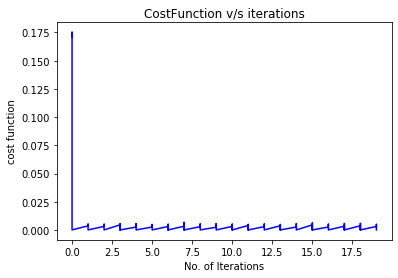

In [432]:
plt.title("CostFunction v/s iterations")
plt.xlabel("No. of Iterations")
plt.ylabel("cost function")
plt.plot(iterationList, costList, color="blue")

In [433]:
from sklearn.metrics import mean_squared_error as mse, r2_score as vs
import math

y_pred = np.dot(X_test,theta)
rmse = math.sqrt(mse(Y_test,y_pred))
print('Root Mean square error = ', rmse);
print('R^2 is = ', vs(Y_test, y_pred))

Root Mean square error =  0.6403661239283367
R^2 is =  0.5756701559662715


# Solution of Question 2 - 3 

Mini batch gradient descent approch is more efficient among 3, as we can compare the number of iteration taking it to converge which ultimately affects the performance.
The itterations taken by,
1. Normal Gradient Descent = 50
2. Stochastic Gradient Descent = 30
3. Mini batch Gradient Descent = 20

Hence we can conclude that MiniBatch Gradient Descent is best approach among 3 algorithms.